# Faster-RCNN object detection on Waymo dataset

Reference:(https://github.com/waymo-research/waymo-open-dataset/blob/master/tutorial/tutorial.ipynb), (https://pytorch.org/tutorials/intermediate/torchvision_tutorial.html). 

In [2]:
import os
import tensorflow.compat.v1 as tf
import math
import numpy as np
import itertools
import utils
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from PIL import Image
from glob import glob
tf.enable_eager_execution()

from waymo_open_dataset.utils import range_image_utils
from waymo_open_dataset.utils import transform_utils
from waymo_open_dataset.utils import  frame_utils
from waymo_open_dataset import dataset_pb2 as open_dataset
from engine import train_one_epoch, evaluate


In [3]:
import torch
import torch.utils.data as data

In [4]:
DATA_FOLDER = "../data/training_0000"

print (torch.cuda.is_available())
print (torch.cuda.device_count())
print (torch.cuda.get_device_name())
device = torch.device("cuda")

True
1
GeForce GTX 980 Ti


In [5]:
import transforms as T

def get_transform(train):
    transforms = []
    transforms.append(T.ToTensor())
    if train:
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)

In [6]:
class WaymoDataset(data.Dataset):
    def __init__(self, root, transforms=None):
        self.label_map = {0:0, 1: 1, 2:2, 4:3}
        self.root = root
        self.transforms = transforms
        train_folders = ["training_0000", "training_0001"]
        self.data_files = [path for x in train_folders for path in glob(os.path.join(root, x, "*"))]
#         self.data_files = list(sorted(os.listdir(root)))
        dataset = [tf.data.TFRecordDataset(FILENAME, compression_type='') for FILENAME in self.data_files]
        self.frames = []
        for i, data_file in enumerate(dataset):
            if i % 3 == 0:
                print ("data_file %s being processed"%(i))
            for idx, data in enumerate(data_file):
                if idx % 5 != 0:
                    continue
                frame = open_dataset.Frame()
                frame.ParseFromString(bytearray(data.numpy()))
                self.frames.append(frame)
        
        self.targets = []
        del_indexes = []
        for i, frame in enumerate(self.frames):
            
            target = {}
            target_bbox = []
            target_labels = []
            target_areas = []
        
            for camera_labels in frame.camera_labels:
                
                if camera_labels.name != 1:
                    continue
                    
                for label in camera_labels.labels:                    
                    xmin= label.box.center_x - 0.5 * label.box.length
                    ymin = label.box.center_y - 0.5 * label.box.width
                    xmax = xmin + label.box.length
                    ymax = ymin + label.box.width
                    area = label.box.length * label.box.width
                    target_bbox.append([xmin, ymin, xmax, ymax])
                    target_labels.append(self.label_map[label.type])
                    target_areas.append(area)
                    
            target['boxes'] = torch.as_tensor(target_bbox, dtype=torch.float32)
            target['labels'] = torch.as_tensor(np.array(target_labels), dtype=torch.int64)
            target['image_id'] = torch.tensor([int(frame.context.name.split("_")[-2] + str(i))])
            target["area"] = torch.as_tensor(target_areas, dtype=torch.float32)
            target["iscrowd"] = torch.zeros((len(target['boxes'])), dtype=torch.int64)
            if len(target_bbox) > 0:
                self.targets.append(target)
            else:
                del_indexes.append(i)
        
        for index in sorted(del_indexes, reverse=True):
            del self.frames[index]

        
    def __getitem__(self, index):
        img = Image.fromarray(tf.image.decode_jpeg(self.frames[index].images[0].image).numpy()).convert("RGB")
        target = self.targets[index]
        if self.transforms is not None:
            img, target = self.transforms(img, target)

        return img, target

    def __len__(self):
        return len(self.frames)

In [ ]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

def get_model(num_classes):
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)

    in_features = model.roi_heads.box_predictor.cls_score.in_features

    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    
    return model

In [7]:
# train on the GPU or on the CPU, if a GPU is not available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

num_classes = 4
# use our dataset and defined transformations
dataset = WaymoDataset('../data', get_transform(train=True))
# dataset_test = WaymoDataset('../data/training_0000', get_transform(train=False))

# split the dataset in train and test set
indices = torch.randperm(len(dataset)).tolist()
dataset_train = torch.utils.data.Subset(dataset, indices[:-100])
dataset.transforms = get_transform(train=False)
dataset_test = torch.utils.data.Subset(dataset, indices[-100:])

# define training and validation data loaders
data_loader = torch.utils.data.DataLoader(
    dataset_train, batch_size=2, shuffle=True, num_workers=4,
    collate_fn=utils.collate_fn)

data_loader_test = torch.utils.data.DataLoader(
    dataset_test, batch_size=1, shuffle=False, num_workers=4,
    collate_fn=utils.collate_fn)


data_file 0 being processed
data_file 3 being processed
data_file 6 being processed
data_file 9 being processed
data_file 12 being processed
data_file 15 being processed
data_file 18 being processed
data_file 21 being processed
data_file 24 being processed
data_file 27 being processed
data_file 30 being processed
data_file 33 being processed
data_file 36 being processed
data_file 39 being processed
data_file 42 being processed
data_file 45 being processed


In [8]:
print (len(dataset))
print (len(dataset_test))

1879
100


In [9]:
num_classes = 4
# get the model using our helper function
model = get_model(num_classes)

# move model to the right device
model.to(device)

# construct an optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005,
                            momentum=0.9, weight_decay=0.0005)
# and a learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,
                                               step_size=3,
                                               gamma=0.1)


In [10]:
MODEL_DIR = "saved_models"
num_epochs = 10

In [11]:
evaluate(model, data_loader_test, device=device)

creating index...
index created!
Test:  [  0/100]  eta: 0:03:11  model_time: 1.2721 (1.2721)  evaluator_time: 0.0801 (0.0801)  time: 1.9200  data: 0.5464  max mem: 579
Test:  [ 99/100]  eta: 0:00:00  model_time: 0.1096 (0.1213)  evaluator_time: 0.0289 (0.0343)  time: 0.1507  data: 0.0040  max mem: 579
Test: Total time: 0:00:17 (0.1726 s / it)
Averaged stats: model_time: 0.1096 (0.1213)  evaluator_time: 0.0289 (0.0343)
Accumulating evaluation results...
DONE (t=0.14s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.004
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.020
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.001
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.008
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.009
 Average Recall     (AR) @[ Io

In [13]:
for epoch in range(num_epochs):
    torch.save(model.state_dict(), os.path.join(MODEL_DIR, "model_%s.pth"%(epoch)))
    # train for one epoch, printing every 10 iterations
    train_one_epoch(model, optimizer, data_loader, device, epoch, print_freq=10)
    # update the learning rate
    lr_scheduler.step()
    # evaluate on the test dataset
    
print("That's it!")

Epoch: [0]  [  0/890]  eta: 0:16:28  lr: 0.000011  loss: 2.0158 (2.0158)  loss_classifier: 1.0253 (1.0253)  loss_box_reg: 0.5453 (0.5453)  loss_objectness: 0.0655 (0.0655)  loss_rpn_box_reg: 0.3797 (0.3797)  time: 1.1102  data: 0.5429  max mem: 2710
Epoch: [0]  [ 10/890]  eta: 0:08:29  lr: 0.000067  loss: 2.0859 (2.0423)  loss_classifier: 0.9600 (0.9496)  loss_box_reg: 0.5591 (0.5288)  loss_objectness: 0.1056 (0.1935)  loss_rpn_box_reg: 0.3749 (0.3703)  time: 0.5795  data: 0.0562  max mem: 2726
Epoch: [0]  [ 20/890]  eta: 0:08:01  lr: 0.000123  loss: 1.9521 (1.9067)  loss_classifier: 0.8017 (0.8408)  loss_box_reg: 0.5514 (0.5148)  loss_objectness: 0.0763 (0.1582)  loss_rpn_box_reg: 0.3904 (0.3930)  time: 0.5258  data: 0.0078  max mem: 2726
Epoch: [0]  [ 30/890]  eta: 0:07:48  lr: 0.000179  loss: 1.6356 (1.7748)  loss_classifier: 0.6656 (0.7570)  loss_box_reg: 0.5258 (0.5108)  loss_objectness: 0.0637 (0.1251)  loss_rpn_box_reg: 0.3904 (0.3819)  time: 0.5251  data: 0.0080  max mem: 2726


Epoch: [0]  [330/890]  eta: 0:05:20  lr: 0.001865  loss: 0.8575 (1.0214)  loss_classifier: 0.2191 (0.3000)  loss_box_reg: 0.1754 (0.2735)  loss_objectness: 0.0484 (0.0725)  loss_rpn_box_reg: 0.3945 (0.3755)  time: 0.5953  data: 0.0079  max mem: 2795
Epoch: [0]  [340/890]  eta: 0:05:14  lr: 0.001921  loss: 0.8737 (1.0164)  loss_classifier: 0.2197 (0.2973)  loss_box_reg: 0.1799 (0.2706)  loss_objectness: 0.0491 (0.0724)  loss_rpn_box_reg: 0.3926 (0.3760)  time: 0.5958  data: 0.0078  max mem: 2795
Epoch: [0]  [350/890]  eta: 0:05:09  lr: 0.001977  loss: 0.8773 (1.0124)  loss_classifier: 0.2081 (0.2949)  loss_box_reg: 0.1890 (0.2689)  loss_objectness: 0.0491 (0.0720)  loss_rpn_box_reg: 0.4144 (0.3766)  time: 0.5950  data: 0.0078  max mem: 2795
Epoch: [0]  [360/890]  eta: 0:05:03  lr: 0.002033  loss: 0.8297 (1.0044)  loss_classifier: 0.1970 (0.2913)  loss_box_reg: 0.1908 (0.2661)  loss_objectness: 0.0485 (0.0716)  loss_rpn_box_reg: 0.4144 (0.3754)  time: 0.5942  data: 0.0078  max mem: 2795


Epoch: [0]  [660/890]  eta: 0:02:14  lr: 0.003719  loss: 0.8472 (0.9056)  loss_classifier: 0.1907 (0.2519)  loss_box_reg: 0.1695 (0.2284)  loss_objectness: 0.0496 (0.0627)  loss_rpn_box_reg: 0.4032 (0.3625)  time: 0.5943  data: 0.0079  max mem: 2795
Epoch: [0]  [670/890]  eta: 0:02:08  lr: 0.003775  loss: 0.8472 (0.9042)  loss_classifier: 0.1891 (0.2510)  loss_box_reg: 0.1873 (0.2275)  loss_objectness: 0.0496 (0.0629)  loss_rpn_box_reg: 0.4032 (0.3627)  time: 0.5932  data: 0.0079  max mem: 2795
Epoch: [0]  [680/890]  eta: 0:02:02  lr: 0.003831  loss: 0.7792 (0.9019)  loss_classifier: 0.1891 (0.2506)  loss_box_reg: 0.1822 (0.2269)  loss_objectness: 0.0498 (0.0629)  loss_rpn_box_reg: 0.2736 (0.3614)  time: 0.5939  data: 0.0079  max mem: 2806
Epoch: [0]  [690/890]  eta: 0:01:56  lr: 0.003888  loss: 0.8424 (0.9009)  loss_classifier: 0.2225 (0.2503)  loss_box_reg: 0.2000 (0.2263)  loss_objectness: 0.0471 (0.0627)  loss_rpn_box_reg: 0.2896 (0.3616)  time: 0.5963  data: 0.0078  max mem: 2806


Epoch: [1]  [ 90/890]  eta: 0:07:59  lr: 0.005000  loss: 0.6821 (0.7406)  loss_classifier: 0.1709 (0.1902)  loss_box_reg: 0.1626 (0.1651)  loss_objectness: 0.0392 (0.0437)  loss_rpn_box_reg: 0.2892 (0.3416)  time: 0.5924  data: 0.0079  max mem: 2851
Epoch: [1]  [100/890]  eta: 0:07:52  lr: 0.005000  loss: 0.6821 (0.7357)  loss_classifier: 0.1849 (0.1901)  loss_box_reg: 0.1664 (0.1647)  loss_objectness: 0.0392 (0.0433)  loss_rpn_box_reg: 0.2935 (0.3375)  time: 0.5940  data: 0.0079  max mem: 2851
Epoch: [1]  [110/890]  eta: 0:07:46  lr: 0.005000  loss: 0.7291 (0.7345)  loss_classifier: 0.1935 (0.1899)  loss_box_reg: 0.1670 (0.1641)  loss_objectness: 0.0286 (0.0425)  loss_rpn_box_reg: 0.3112 (0.3378)  time: 0.5933  data: 0.0079  max mem: 2851
Epoch: [1]  [120/890]  eta: 0:07:40  lr: 0.005000  loss: 0.8118 (0.7403)  loss_classifier: 0.2013 (0.1917)  loss_box_reg: 0.1748 (0.1657)  loss_objectness: 0.0307 (0.0432)  loss_rpn_box_reg: 0.3461 (0.3396)  time: 0.5936  data: 0.0079  max mem: 2851


Epoch: [1]  [420/890]  eta: 0:04:39  lr: 0.005000  loss: 0.7370 (0.7215)  loss_classifier: 0.1827 (0.1851)  loss_box_reg: 0.1657 (0.1638)  loss_objectness: 0.0333 (0.0470)  loss_rpn_box_reg: 0.3079 (0.3255)  time: 0.5927  data: 0.0078  max mem: 2851
Epoch: [1]  [430/890]  eta: 0:04:33  lr: 0.005000  loss: 0.6215 (0.7207)  loss_classifier: 0.1707 (0.1849)  loss_box_reg: 0.1364 (0.1636)  loss_objectness: 0.0285 (0.0467)  loss_rpn_box_reg: 0.2799 (0.3256)  time: 0.5931  data: 0.0077  max mem: 2851
Epoch: [1]  [440/890]  eta: 0:04:27  lr: 0.005000  loss: 0.6460 (0.7197)  loss_classifier: 0.1724 (0.1845)  loss_box_reg: 0.1522 (0.1634)  loss_objectness: 0.0287 (0.0464)  loss_rpn_box_reg: 0.2817 (0.3255)  time: 0.5938  data: 0.0078  max mem: 2851
Epoch: [1]  [450/890]  eta: 0:04:21  lr: 0.005000  loss: 0.6065 (0.7174)  loss_classifier: 0.1619 (0.1838)  loss_box_reg: 0.1522 (0.1627)  loss_objectness: 0.0307 (0.0461)  loss_rpn_box_reg: 0.2859 (0.3247)  time: 0.5915  data: 0.0078  max mem: 2851


Epoch: [1]  [750/890]  eta: 0:01:23  lr: 0.005000  loss: 0.7936 (0.7008)  loss_classifier: 0.1810 (0.1778)  loss_box_reg: 0.1654 (0.1586)  loss_objectness: 0.0428 (0.0442)  loss_rpn_box_reg: 0.3746 (0.3202)  time: 0.5946  data: 0.0078  max mem: 2851
Epoch: [1]  [760/890]  eta: 0:01:17  lr: 0.005000  loss: 0.7707 (0.7020)  loss_classifier: 0.1907 (0.1781)  loss_box_reg: 0.1743 (0.1588)  loss_objectness: 0.0380 (0.0441)  loss_rpn_box_reg: 0.3697 (0.3210)  time: 0.5930  data: 0.0078  max mem: 2851
Epoch: [1]  [770/890]  eta: 0:01:11  lr: 0.005000  loss: 0.6915 (0.7002)  loss_classifier: 0.1466 (0.1774)  loss_box_reg: 0.1274 (0.1582)  loss_objectness: 0.0325 (0.0441)  loss_rpn_box_reg: 0.3152 (0.3204)  time: 0.5917  data: 0.0078  max mem: 2851
Epoch: [1]  [780/890]  eta: 0:01:05  lr: 0.005000  loss: 0.5900 (0.6998)  loss_classifier: 0.1291 (0.1774)  loss_box_reg: 0.1306 (0.1586)  loss_objectness: 0.0290 (0.0440)  loss_rpn_box_reg: 0.2760 (0.3199)  time: 0.5907  data: 0.0078  max mem: 2851


Epoch: [2]  [180/890]  eta: 0:07:03  lr: 0.005000  loss: 0.6064 (0.6274)  loss_classifier: 0.1520 (0.1565)  loss_box_reg: 0.1423 (0.1442)  loss_objectness: 0.0342 (0.0346)  loss_rpn_box_reg: 0.2861 (0.2920)  time: 0.5937  data: 0.0078  max mem: 2851
Epoch: [2]  [190/890]  eta: 0:06:57  lr: 0.005000  loss: 0.6337 (0.6261)  loss_classifier: 0.1520 (0.1568)  loss_box_reg: 0.1423 (0.1447)  loss_objectness: 0.0342 (0.0344)  loss_rpn_box_reg: 0.3085 (0.2902)  time: 0.5937  data: 0.0079  max mem: 2851
Epoch: [2]  [200/890]  eta: 0:06:51  lr: 0.005000  loss: 0.5504 (0.6215)  loss_classifier: 0.1212 (0.1551)  loss_box_reg: 0.1133 (0.1430)  loss_objectness: 0.0221 (0.0340)  loss_rpn_box_reg: 0.2651 (0.2893)  time: 0.5929  data: 0.0079  max mem: 2851
Epoch: [2]  [210/890]  eta: 0:06:45  lr: 0.005000  loss: 0.5654 (0.6228)  loss_classifier: 0.1447 (0.1555)  loss_box_reg: 0.1120 (0.1433)  loss_objectness: 0.0287 (0.0339)  loss_rpn_box_reg: 0.2651 (0.2901)  time: 0.5932  data: 0.0079  max mem: 2851


Epoch: [2]  [510/890]  eta: 0:03:45  lr: 0.005000  loss: 0.5385 (0.6064)  loss_classifier: 0.1472 (0.1508)  loss_box_reg: 0.1354 (0.1382)  loss_objectness: 0.0270 (0.0315)  loss_rpn_box_reg: 0.2339 (0.2859)  time: 0.5928  data: 0.0078  max mem: 2851
Epoch: [2]  [520/890]  eta: 0:03:39  lr: 0.005000  loss: 0.6231 (0.6073)  loss_classifier: 0.1392 (0.1508)  loss_box_reg: 0.1465 (0.1384)  loss_objectness: 0.0270 (0.0316)  loss_rpn_box_reg: 0.2659 (0.2865)  time: 0.5920  data: 0.0079  max mem: 2851
Epoch: [2]  [530/890]  eta: 0:03:33  lr: 0.005000  loss: 0.6317 (0.6073)  loss_classifier: 0.1472 (0.1513)  loss_box_reg: 0.1415 (0.1384)  loss_objectness: 0.0254 (0.0316)  loss_rpn_box_reg: 0.2946 (0.2860)  time: 0.5946  data: 0.0078  max mem: 2851
Epoch: [2]  [540/890]  eta: 0:03:27  lr: 0.005000  loss: 0.5895 (0.6065)  loss_classifier: 0.1403 (0.1511)  loss_box_reg: 0.1180 (0.1384)  loss_objectness: 0.0254 (0.0316)  loss_rpn_box_reg: 0.2946 (0.2854)  time: 0.5938  data: 0.0078  max mem: 2851


Epoch: [2]  [840/890]  eta: 0:00:29  lr: 0.005000  loss: 0.5259 (0.6126)  loss_classifier: 0.1361 (0.1527)  loss_box_reg: 0.1068 (0.1400)  loss_objectness: 0.0247 (0.0321)  loss_rpn_box_reg: 0.2591 (0.2879)  time: 0.5922  data: 0.0079  max mem: 2851
Epoch: [2]  [850/890]  eta: 0:00:23  lr: 0.005000  loss: 0.5548 (0.6125)  loss_classifier: 0.1256 (0.1525)  loss_box_reg: 0.1271 (0.1399)  loss_objectness: 0.0242 (0.0320)  loss_rpn_box_reg: 0.2811 (0.2880)  time: 0.5923  data: 0.0079  max mem: 2851
Epoch: [2]  [860/890]  eta: 0:00:17  lr: 0.005000  loss: 0.6085 (0.6125)  loss_classifier: 0.1349 (0.1525)  loss_box_reg: 0.1370 (0.1399)  loss_objectness: 0.0242 (0.0320)  loss_rpn_box_reg: 0.3039 (0.2880)  time: 0.5926  data: 0.0078  max mem: 2851
Epoch: [2]  [870/890]  eta: 0:00:11  lr: 0.005000  loss: 0.6256 (0.6125)  loss_classifier: 0.1543 (0.1525)  loss_box_reg: 0.1370 (0.1400)  loss_objectness: 0.0282 (0.0321)  loss_rpn_box_reg: 0.2779 (0.2879)  time: 0.5933  data: 0.0078  max mem: 2851


Epoch: [3]  [270/890]  eta: 0:06:09  lr: 0.000500  loss: 0.4989 (0.5294)  loss_classifier: 0.1133 (0.1301)  loss_box_reg: 0.1070 (0.1225)  loss_objectness: 0.0181 (0.0233)  loss_rpn_box_reg: 0.1855 (0.2535)  time: 0.5930  data: 0.0078  max mem: 2851
Epoch: [3]  [280/890]  eta: 0:06:03  lr: 0.000500  loss: 0.5411 (0.5274)  loss_classifier: 0.1176 (0.1293)  loss_box_reg: 0.1156 (0.1221)  loss_objectness: 0.0210 (0.0231)  loss_rpn_box_reg: 0.2834 (0.2529)  time: 0.5953  data: 0.0078  max mem: 2851
Epoch: [3]  [290/890]  eta: 0:05:57  lr: 0.000500  loss: 0.5411 (0.5289)  loss_classifier: 0.1184 (0.1297)  loss_box_reg: 0.1156 (0.1222)  loss_objectness: 0.0210 (0.0231)  loss_rpn_box_reg: 0.2759 (0.2538)  time: 0.5938  data: 0.0079  max mem: 2851
Epoch: [3]  [300/890]  eta: 0:05:51  lr: 0.000500  loss: 0.5673 (0.5287)  loss_classifier: 0.1339 (0.1297)  loss_box_reg: 0.1182 (0.1221)  loss_objectness: 0.0174 (0.0229)  loss_rpn_box_reg: 0.2699 (0.2540)  time: 0.5937  data: 0.0078  max mem: 2851


Epoch: [3]  [600/890]  eta: 0:02:52  lr: 0.000500  loss: 0.5543 (0.5132)  loss_classifier: 0.1203 (0.1262)  loss_box_reg: 0.1147 (0.1187)  loss_objectness: 0.0255 (0.0225)  loss_rpn_box_reg: 0.2483 (0.2458)  time: 0.5939  data: 0.0078  max mem: 2851
Epoch: [3]  [610/890]  eta: 0:02:46  lr: 0.000500  loss: 0.4898 (0.5129)  loss_classifier: 0.1159 (0.1259)  loss_box_reg: 0.1194 (0.1187)  loss_objectness: 0.0272 (0.0226)  loss_rpn_box_reg: 0.2377 (0.2457)  time: 0.5929  data: 0.0078  max mem: 2851
Epoch: [3]  [620/890]  eta: 0:02:40  lr: 0.000500  loss: 0.4840 (0.5128)  loss_classifier: 0.1135 (0.1260)  loss_box_reg: 0.1194 (0.1186)  loss_objectness: 0.0220 (0.0227)  loss_rpn_box_reg: 0.2114 (0.2456)  time: 0.5933  data: 0.0079  max mem: 2851
Epoch: [3]  [630/890]  eta: 0:02:34  lr: 0.000500  loss: 0.4951 (0.5124)  loss_classifier: 0.1067 (0.1257)  loss_box_reg: 0.1010 (0.1184)  loss_objectness: 0.0167 (0.0226)  loss_rpn_box_reg: 0.2554 (0.2457)  time: 0.5936  data: 0.0079  max mem: 2851


Epoch: [4]  [ 30/890]  eta: 0:08:43  lr: 0.000500  loss: 0.4940 (0.4366)  loss_classifier: 0.1253 (0.1091)  loss_box_reg: 0.1198 (0.1030)  loss_objectness: 0.0195 (0.0180)  loss_rpn_box_reg: 0.2176 (0.2064)  time: 0.5939  data: 0.0079  max mem: 2851
Epoch: [4]  [ 40/890]  eta: 0:08:34  lr: 0.000500  loss: 0.5253 (0.4481)  loss_classifier: 0.1273 (0.1131)  loss_box_reg: 0.1266 (0.1071)  loss_objectness: 0.0220 (0.0198)  loss_rpn_box_reg: 0.2309 (0.2081)  time: 0.5940  data: 0.0079  max mem: 2851
Epoch: [4]  [ 50/890]  eta: 0:08:26  lr: 0.000500  loss: 0.5253 (0.4626)  loss_classifier: 0.1262 (0.1145)  loss_box_reg: 0.1140 (0.1096)  loss_objectness: 0.0228 (0.0205)  loss_rpn_box_reg: 0.2608 (0.2180)  time: 0.5932  data: 0.0079  max mem: 2851
Epoch: [4]  [ 60/890]  eta: 0:08:18  lr: 0.000500  loss: 0.4900 (0.4637)  loss_classifier: 0.1067 (0.1158)  loss_box_reg: 0.1091 (0.1108)  loss_objectness: 0.0205 (0.0207)  loss_rpn_box_reg: 0.2513 (0.2164)  time: 0.5925  data: 0.0078  max mem: 2851


Epoch: [4]  [360/890]  eta: 0:05:15  lr: 0.000500  loss: 0.4382 (0.4820)  loss_classifier: 0.1042 (0.1189)  loss_box_reg: 0.1022 (0.1133)  loss_objectness: 0.0152 (0.0212)  loss_rpn_box_reg: 0.2202 (0.2286)  time: 0.5921  data: 0.0079  max mem: 2851
Epoch: [4]  [370/890]  eta: 0:05:09  lr: 0.000500  loss: 0.4758 (0.4831)  loss_classifier: 0.1077 (0.1190)  loss_box_reg: 0.1061 (0.1136)  loss_objectness: 0.0190 (0.0214)  loss_rpn_box_reg: 0.2234 (0.2291)  time: 0.5926  data: 0.0079  max mem: 2851
Epoch: [4]  [380/890]  eta: 0:05:03  lr: 0.000500  loss: 0.5194 (0.4841)  loss_classifier: 0.1186 (0.1192)  loss_box_reg: 0.1249 (0.1138)  loss_objectness: 0.0202 (0.0214)  loss_rpn_box_reg: 0.2568 (0.2297)  time: 0.5930  data: 0.0079  max mem: 2851
Epoch: [4]  [390/890]  eta: 0:04:57  lr: 0.000500  loss: 0.5194 (0.4861)  loss_classifier: 0.1191 (0.1195)  loss_box_reg: 0.1138 (0.1140)  loss_objectness: 0.0205 (0.0216)  loss_rpn_box_reg: 0.2527 (0.2310)  time: 0.5940  data: 0.0079  max mem: 2851


Epoch: [4]  [690/890]  eta: 0:01:58  lr: 0.000500  loss: 0.4736 (0.4860)  loss_classifier: 0.1137 (0.1194)  loss_box_reg: 0.1104 (0.1137)  loss_objectness: 0.0107 (0.0207)  loss_rpn_box_reg: 0.2499 (0.2321)  time: 0.5951  data: 0.0078  max mem: 2851
Epoch: [4]  [700/890]  eta: 0:01:52  lr: 0.000500  loss: 0.5285 (0.4855)  loss_classifier: 0.1272 (0.1194)  loss_box_reg: 0.1113 (0.1136)  loss_objectness: 0.0228 (0.0207)  loss_rpn_box_reg: 0.2703 (0.2318)  time: 0.5954  data: 0.0079  max mem: 2851
Epoch: [4]  [710/890]  eta: 0:01:46  lr: 0.000500  loss: 0.5014 (0.4867)  loss_classifier: 0.1195 (0.1197)  loss_box_reg: 0.1113 (0.1139)  loss_objectness: 0.0219 (0.0208)  loss_rpn_box_reg: 0.2532 (0.2324)  time: 0.5949  data: 0.0079  max mem: 2851
Epoch: [4]  [720/890]  eta: 0:01:41  lr: 0.000500  loss: 0.5014 (0.4874)  loss_classifier: 0.1202 (0.1198)  loss_box_reg: 0.1146 (0.1140)  loss_objectness: 0.0228 (0.0209)  loss_rpn_box_reg: 0.2872 (0.2327)  time: 0.5935  data: 0.0080  max mem: 2851


Epoch: [5]  [120/890]  eta: 0:07:40  lr: 0.000500  loss: 0.5004 (0.4770)  loss_classifier: 0.1089 (0.1162)  loss_box_reg: 0.1178 (0.1111)  loss_objectness: 0.0174 (0.0191)  loss_rpn_box_reg: 0.2341 (0.2305)  time: 0.5943  data: 0.0080  max mem: 2851
Epoch: [5]  [130/890]  eta: 0:07:34  lr: 0.000500  loss: 0.5401 (0.4837)  loss_classifier: 0.1307 (0.1170)  loss_box_reg: 0.1178 (0.1124)  loss_objectness: 0.0162 (0.0189)  loss_rpn_box_reg: 0.2907 (0.2355)  time: 0.5932  data: 0.0079  max mem: 2851
Epoch: [5]  [140/890]  eta: 0:07:27  lr: 0.000500  loss: 0.5249 (0.4856)  loss_classifier: 0.1188 (0.1167)  loss_box_reg: 0.1134 (0.1125)  loss_objectness: 0.0179 (0.0193)  loss_rpn_box_reg: 0.2671 (0.2371)  time: 0.5930  data: 0.0079  max mem: 2851
Epoch: [5]  [150/890]  eta: 0:07:21  lr: 0.000500  loss: 0.4670 (0.4833)  loss_classifier: 0.1089 (0.1166)  loss_box_reg: 0.1105 (0.1125)  loss_objectness: 0.0203 (0.0193)  loss_rpn_box_reg: 0.1964 (0.2349)  time: 0.5931  data: 0.0079  max mem: 2851


Epoch: [5]  [450/890]  eta: 0:04:21  lr: 0.000500  loss: 0.4725 (0.4816)  loss_classifier: 0.1116 (0.1164)  loss_box_reg: 0.1061 (0.1131)  loss_objectness: 0.0155 (0.0202)  loss_rpn_box_reg: 0.2070 (0.2318)  time: 0.5926  data: 0.0081  max mem: 2851
Epoch: [5]  [460/890]  eta: 0:04:15  lr: 0.000500  loss: 0.4725 (0.4824)  loss_classifier: 0.1179 (0.1166)  loss_box_reg: 0.1009 (0.1131)  loss_objectness: 0.0161 (0.0201)  loss_rpn_box_reg: 0.2070 (0.2325)  time: 0.5938  data: 0.0081  max mem: 2851
Epoch: [5]  [470/890]  eta: 0:04:09  lr: 0.000500  loss: 0.4775 (0.4814)  loss_classifier: 0.1136 (0.1163)  loss_box_reg: 0.1055 (0.1130)  loss_objectness: 0.0181 (0.0202)  loss_rpn_box_reg: 0.2438 (0.2320)  time: 0.5930  data: 0.0081  max mem: 2851
Epoch: [5]  [480/890]  eta: 0:04:03  lr: 0.000500  loss: 0.4929 (0.4814)  loss_classifier: 0.1121 (0.1163)  loss_box_reg: 0.1055 (0.1131)  loss_objectness: 0.0181 (0.0201)  loss_rpn_box_reg: 0.2216 (0.2319)  time: 0.5922  data: 0.0081  max mem: 2851


Epoch: [5]  [780/890]  eta: 0:01:05  lr: 0.000500  loss: 0.4469 (0.4780)  loss_classifier: 0.1149 (0.1163)  loss_box_reg: 0.1129 (0.1122)  loss_objectness: 0.0175 (0.0193)  loss_rpn_box_reg: 0.2118 (0.2302)  time: 0.5939  data: 0.0081  max mem: 2851
Epoch: [5]  [790/890]  eta: 0:00:59  lr: 0.000500  loss: 0.4472 (0.4777)  loss_classifier: 0.1167 (0.1165)  loss_box_reg: 0.1168 (0.1123)  loss_objectness: 0.0229 (0.0194)  loss_rpn_box_reg: 0.1920 (0.2295)  time: 0.5945  data: 0.0081  max mem: 2851
Epoch: [5]  [800/890]  eta: 0:00:53  lr: 0.000500  loss: 0.4488 (0.4777)  loss_classifier: 0.1184 (0.1165)  loss_box_reg: 0.1154 (0.1123)  loss_objectness: 0.0164 (0.0194)  loss_rpn_box_reg: 0.1920 (0.2295)  time: 0.5937  data: 0.0079  max mem: 2851
Epoch: [5]  [810/890]  eta: 0:00:47  lr: 0.000500  loss: 0.4269 (0.4770)  loss_classifier: 0.1138 (0.1164)  loss_box_reg: 0.1083 (0.1123)  loss_objectness: 0.0164 (0.0194)  loss_rpn_box_reg: 0.1814 (0.2290)  time: 0.5933  data: 0.0079  max mem: 2851


KeyboardInterrupt: 

In [14]:
evaluate(model, data_loader_test, device=device)

creating index...
index created!
Test:  [  0/100]  eta: 0:01:12  model_time: 0.1457 (0.1457)  evaluator_time: 0.0914 (0.0914)  time: 0.7213  data: 0.4608  max mem: 2851
Test:  [ 99/100]  eta: 0:00:00  model_time: 0.1095 (0.1096)  evaluator_time: 0.0184 (0.0191)  time: 0.1392  data: 0.0042  max mem: 2851
Test: Total time: 0:00:14 (0.1450 s / it)
Averaged stats: model_time: 0.1095 (0.1096)  evaluator_time: 0.0184 (0.0191)
Accumulating evaluation results...
DONE (t=0.07s).
IoU metric: bbox
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.552
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.116
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.394
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.702
 Average Recall     (AR) @[ 

In [12]:
model.load_state_dict(torch.load("saved_models/model_6.pth"))

<All keys matched successfully>

In [13]:
%matplotlib inline

def show_image(image, target_bbox, pred_bbox, i):
    """Show a camera image and the given camera labels."""
        
    fig, ax = plt.subplots(1, 1, figsize=(10, 7))
    for patch in pred_bbox:
        ax.add_patch(Rectangle(
        xy=(patch[0], patch[1]),
        width=patch[2] - patch[0],
        height=patch[3] - patch[1],
        linewidth=1,
        edgecolor="red",
        facecolor='none'))
    ax.imshow(image)
    
    ax.title.set_text("Prediction")
    ax.grid(False)
    ax.axis('off')
    
    fig.savefig(f"output/test_frame_{i}.png", dpi=fig.dpi)
#     plt.show()

In [14]:
INFERENCE_FILE = "../data/testing_0000/segment-15272375112495403395_620_000_640_000_with_camera_labels.tfrecord"

In [15]:
label_map = {0:0, 1: 1, 2:2, 4:3}
score_threshold = 0.4

data_file = tf.data.TFRecordDataset(INFERENCE_FILE, compression_type='')

frames = []

for idx, data in enumerate(data_file):
    frame = open_dataset.Frame()
    frame.ParseFromString(bytearray(data.numpy()))
    frames.append(frame)

In [16]:
len(frames)

196

In [17]:
from matplotlib.pyplot import figure

In [18]:
def get_dummy_target():
    target = {}
    target['boxes'] = torch.as_tensor([[0.,0.,0.,0.]], dtype=torch.float32).to(device)
    target['labels'] = torch.as_tensor(np.array([[0]]), dtype=torch.int64).to(device)
    target['image_id'] = torch.tensor([int(frame.context.name.split("_")[-2] + str(i))]).to(device)
    target["area"] = torch.as_tensor([[0.]], dtype=torch.float32).to(device)
    target["iscrowd"] = torch.zeros((len(target['boxes'])), dtype=torch.int64).to(device)
    return target

/home/phoenix/anaconda3/envs/hm2/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


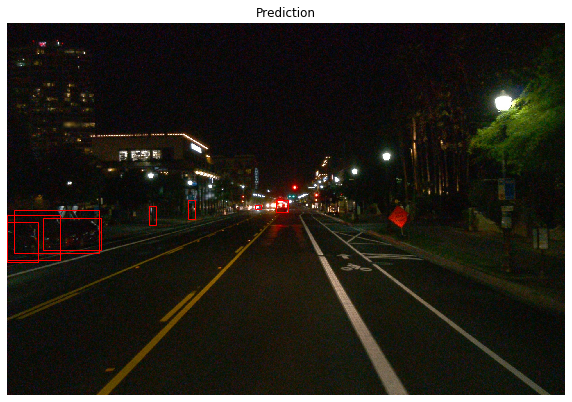

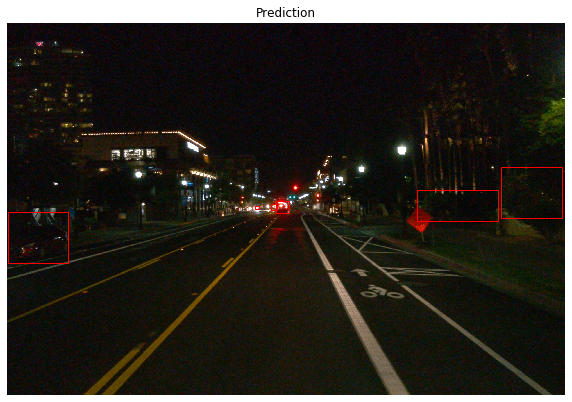

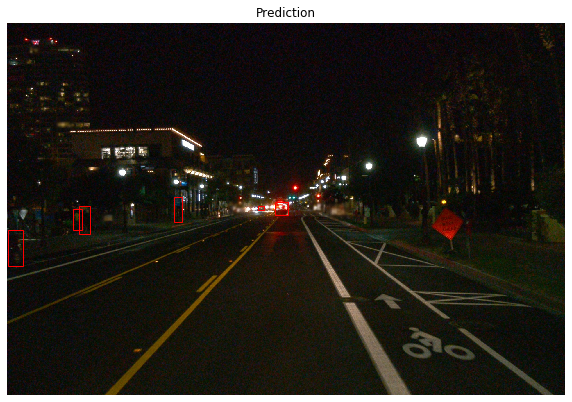

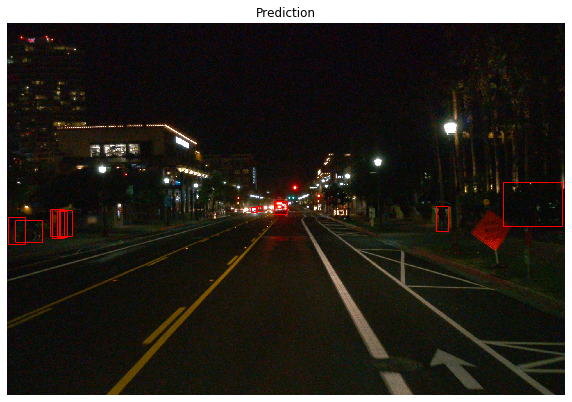

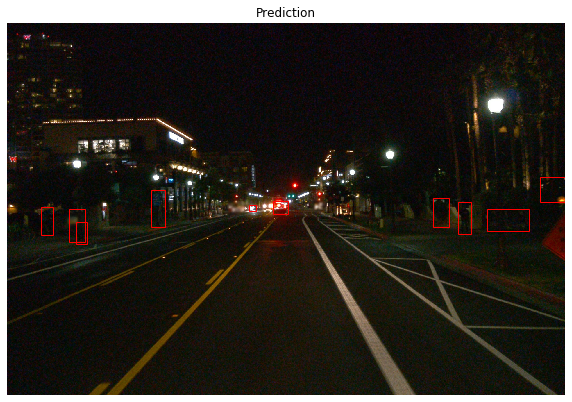

...

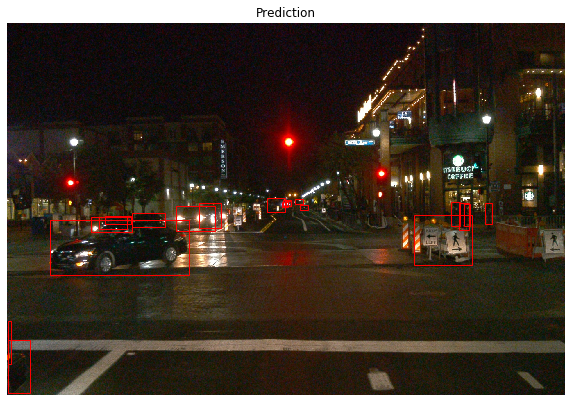

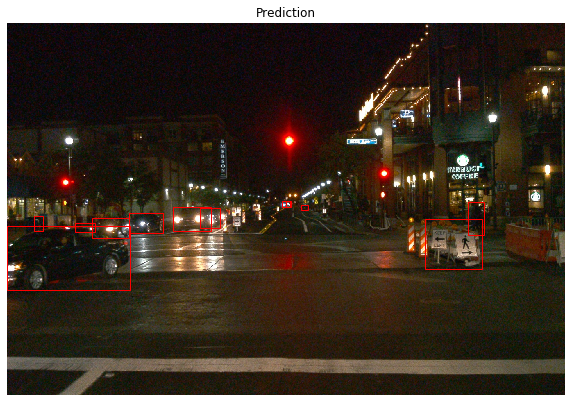

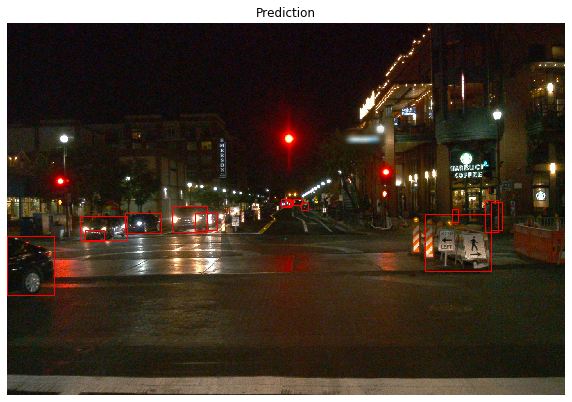

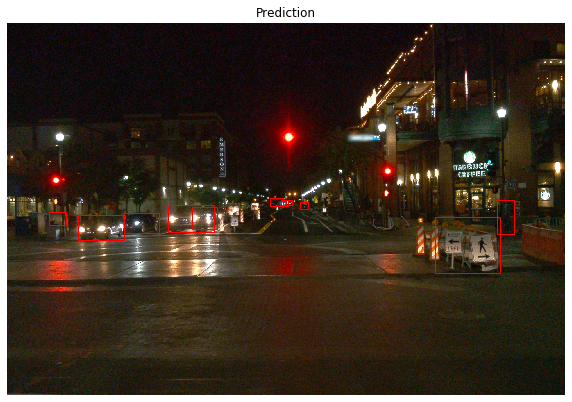

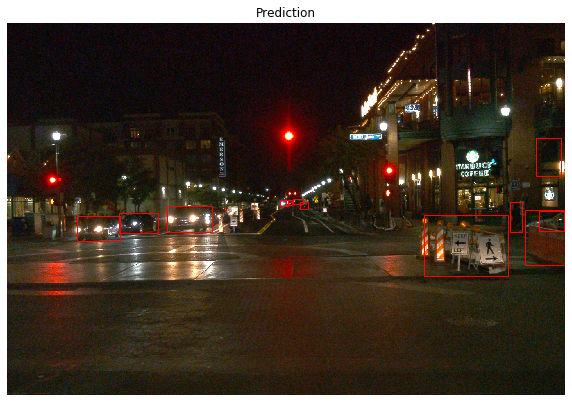

In [ ]:
model.eval()
for i, frame in enumerate(frames):
    image = tf.image.decode_jpeg(frame.images[0].image).numpy()
    if i%5 != 0:
        continue
    
            
    img = Image.fromarray(image)
    target = get_dummy_target()

    img, target = get_transform(train=False)(img, target)
    
    output = model.forward([img.to(device)], [target])

    pred_bbox = [x.data.cpu().numpy() for idx, x in enumerate(output[0]['boxes']) if output[0]["scores"][idx] > score_threshold]
    show_image(image, target_bbox, pred_bbox, i)